In [59]:
# pip install ffmpy
import ffmpy

ff = ffmpy.FFmpeg(inputs={'path_of_video.mp4':None },
                  outputs={'frame.jpg': '-ss 00:00:02 -t 00:00:2 -s 400x400 -r 1 -f mjpeg'})

ff.run()

FFRuntimeError: `ffmpeg -i path_of_video.mp4 -ss 00:00:02 -t 00:00:2 -s 400x400 -r 1 -f mjpeg frame.jpg` exited with status 1

STDOUT:


STDERR:


In [4]:
# for no .mov format
# import the necessary packages
# https://www.pyimagesearch.com/2017/02/06/faster-video-file-fps-with-cv2-videocapture-and-opencv/
from threading import Thread
import sys
import cv2

class FileVideoStream:
    def __init__(self, path, queueSize=128):
        # initialize the file video stream along with the boolean
        # used to indicate if the thread should be stopped or not
        self.stream = cv2.VideoCapture(path)
        self.stopped = False
 
        # initialize the queue used to store frames read from the video file
        self.Q = Queue(maxsize=queueSize)
        
    def start(self):
        # start a thread to read frames from the file video stream
        t = Thread(target=self.update, args=())
        t.daemon = True
        t.start()
        return self

    def update(self):
        # keep looping infinitely
        while True:
            # if the thread indicator variable is set, stop the thread
            if self.stopped: return
            # otherwise, ensure the queue has room in it
            if not self.Q.full():
                # read the next frame from the file
                (grabbed, frame) = self.stream.read()
                # if the `grabbed` boolean is `False`, then we have
                # reached the end of the video file
                if not grabbed:
                    self.stop()
                    return
                # add the frame to the queue
                self.Q.put(frame)
                
    def read(self):
        # return next frame in the queue
        return self.Q.get()
    

    def more(self):
        # return True if there are still frames in the queue
        return self.Q.qsize() > 0

In [ ]:
## EXAMPLE OF BLENDING

import cv2
import numpy as np
 
# Read images : src image will be cloned into dst
im = cv2.imread("images/wood-texture.jpg")
obj= cv2.imread("images/iloveyouticket.jpg")
 
# Create an all white mask
mask = 255 * np.ones(obj.shape, obj.dtype)
 
# The location of the center of the src in the dst
width, height, channels = im.shape
center = (height//2, width//2)
 
print(obj.dtype, im.dtype, mask.dtype)
# Seamlessly clone src into dst and put the results in output
normal_clone = cv2.seamlessClone(obj, im, mask, center, cv2.NORMAL_CLONE)
mixed_clone = cv2.seamlessClone(obj, im, mask, center, cv2.MIXED_CLONE)
 
# Write results
cv2.imwrite("images/opencv-normal-clone-example.jpg", normal_clone)
cv2.imwrite("images/opencv-mixed-clone-example.jpg", mixed_clone)

plot_ims(np.array([normal_clone, mixed_clone]), alpha=False)

In [ ]:
im = out[:,:,:3]; plot_im(im); print(out.dtype)
blur = cv2.bilateralFilter(im, 9, 75, 75)
blend1, blend2 = seamlessClone(im, im)
plot_ims(np.array([blend1, blend2]))
blur = cv2.blur(img,(5,5))

In [2]:
# conda install av -c conda-forge
# http://mikeboers.github.io/PyAV/
import numpy as np
import cv2
from glob import glob
import os
import operator
from functools import reduce
import av

def save_frames(i_p, o_p, step=None):
    # for each video:
    try:
        container = av.open(i_p)
        if not os.path.exists(o_p): os.makedirs(o_p)
        else: print('Warning: "%s" dir for %s exists, adding files' %o_p)
        for frame in container.decode(video=0):
            if frame.index % step == 0: 
                # save a frame every 10: 3 frames per second (@30fps) 
                frame.to_image().save(os.path.join(o_p, 'frame-%04d.png' %frame.index))
    except: 
        print('Unable to process video file %s' %i_p)

def compFramesFromVideo(i_p, o_p, step=10, ext='.mov', sample_size=None):
    # setting paths
    i_pl = sorted(reduce(operator.add, [glob(os.path.join(i_p, '*' + ext))]))
    o_p = os.path.join(o_p, 'output_frames')
    if not os.path.exists(o_p): os.makedirs(o_p)
    else: print('Warning: "output" dir exists, adding files')
        
    if not sample_size: sample_size = len(i_pl)
        
    print('Total number of found videos: %d   |   extenssion: %s' %(len(i_pl), ext))

    for i in i_pl[:sample_size]:
        print('Processing video file %s' %i)
        f_name = i.split('/')[-1].split('.')[0]
        o_pfname = os.path.join(o_p, f_name)
        save_frames(i, o_pfname, step)

# video_data_i_p = 'data'

# i_p = video_data_i_p
# i_pl = reduce(operator.add, [glob(os.path.join(i_p, '*.mov'))])
# print('Total number of found videos: %d   |   extenssion: .mov' %len(i_pl))

# # compFramesFromVideo(video_data_i_p, '.', step=5)

#### FUNCTIONS

In [6]:
import sys
sys.path.append('../../utils')
import libraries
from utils import *

# import operator
# from functools import reduce
# import av
# import traceback
# import logging
# import random

% matplotlib inline

In [7]:
def seamlessClone(src, dst): 
    
    # create an all white mask
    src_mask = 255 * np.ones(src.shape, dst.dtype)

    # the location of the center of the src in the dst
    width, height, channels = src.shape
    center = (height//2, width//2)

    # seamlessly clone src into dst and put the results in output --all args should be int.
    normal_clone = cv2.seamlessClone(src, dst, src_mask, center, cv2.NORMAL_CLONE)
    mixed_clone = cv2.seamlessClone(src, dst, src_mask, center, cv2.MIXED_CLONE)
    
    return normal_clone, mixed_clone

def composeTextureMaps(i_p, o_p, f_name, blend=False, vis=True, sample_size=None, save_occlusions=False):
    """
    https://www.learnopencv.com/seamless-cloning-using-opencv-python-cpp/
    i_p: path to the .isomap.png images folder
    o_p: output path -by default create an 'fitting' folder in 'i_p' [.obj and .isomap.png]
    sample_size: if desired to compute a sample of the images instead of all the 'ims_path' folders
    """

    # setting paths
    i_p = os.path.join(i_p, 'fitting')       
    i_pl = sorted(glob(os.path.join(i_p, '*.isomap.png')))
    if len(i_pl) == 0: return None
    if not sample_size: sample_size = len(i_pl)
    
    if not os.path.exists(o_p): os.makedirs(o_p)
    
    im_init = None    
    im_last_blend = None
    
    if save_occlusions: 
        occ_op = 'output_occlusions' 
        if not os.path.exists(occ_op): os.makedirs(occ_op)
        cm_p = 'resources/masks/contour_mask.png'
        im_cm = cv2.imread(cm_p)

    # loop over the input folder omitting '*_mirror.isomap.png' files if exist:
    for _, i in enumerate(i_pl[:sample_size]):

        im = cv2.imread(i, cv2.IMREAD_UNCHANGED)
        im_mask = im[:,:,3] == 0
        
        if _ == 0:
            im_init = im            
            im_last_blend = im
            continue

        ## compose and blend
        # save a mask with the occluded areas
        if save_occlusions:
            occ_sample = 255 - np.multiply((im_mask), im_cm[:,:,0]//255) * 255
            cv2.imwrite(os.path.join(occ_op, f_name + '_' + str(_) + '.png'), occ_sample)
        
        # create masks
        im_filled = im_last_blend.copy()
        im_filled_mask = im_last_blend[:,:,3] == 0
        
        # fills the missing areas -info provided by the mask
        im_filled[:,:,:3][im_filled_mask] = im[:,:,:3][im_filled_mask]
        im_filled_mask[im_filled_mask] = im_mask[im_filled_mask]
        
        # blends a bit the last and new image
        if blend: im_filled, _ = seamlessClone(im_last_blend[:,:,:3], im_filled[:,:,:3])
        
        im_filled_mask = (np.reshape((~im_filled_mask).astype(np.uint8), im_filled_mask.shape + (1,)) * 255).astype(np.uint8)
        im_filled = np.append(im_filled[:,:,:3], im_filled_mask, axis=2)
        im_last_blend = im_filled 

    # show off
    if vis: plot_ims(np.array([im_init[:,:,:3], im_last_blend[:,:,:3]]), alpha=False)
    
    # save first and last image
    o_p_init = 'output_input_init'
    cv2.imwrite(os.path.join(o_p_init, f_name + '.isomap.png'), im_init)
    cv2.imwrite(os.path.join(o_p, f_name + '.isomap.png'), im_last_blend)
    
    return im_last_blend

def getPercentageMissing(i_p, vis=False, sample_size=None):
    
    """
    i_path: path to the .isomap.png images folder
    o_path: output path -by default create an 'isomaps' folder in 'ims_path' [.obj and .isomap.png]
    sample_size: if desired to compute a sample of the images instead of all the 'ims_path' folders
    """

    # setting paths
    i_p = os.path.join(i_p, 'fitting')
    i_pl = sorted(glob(os.path.join(i_p, '*.isomap.png')))
    
    try:
        assert len(i_pl) > 0, '  Not enough data to pair for ID %s' %f_name
    except: return None, None

    if not sample_size: sample_size = len(i_pl)
    
    im_init = None    
    im_last_blend = None
    
    percents_dist = []

    for _, i in enumerate(i_pl[:sample_size]):

        im = cv2.imread(i, cv2.IMREAD_UNCHANGED)
        im_mask = im[:,:,3] == 0
        
        npixels = im_mask.size
        zeros = np.count_nonzero(im_mask==0) # nonzeros = im_mask.sum()
        pzeros = zeros / npixels
        
        percents_dist.append(pzeros)
    
    if vis and len(percents_dist) > 0: 
        print('min: %f   max: %f   q5: %f   q10: %f   q15: %f   q20: %f   q25: %f' %(
            min(percents_dist), 
            max(percents_dist), 
            np.percentile(percents_dist, 5), 
            np.percentile(percents_dist, 10), 
            np.percentile(percents_dist, 15),
            np.percentile(percents_dist, 20),
            np.percentile(percents_dist, 25)))
    
    if vis: plot_distribution(percents_dist, i_p)
    
    # generates a (dictionary) mapping of texture map file: percent data per id
    assert len(i_pl) == len(percents_dist)
    file_percent_map = dict(zip(i_pl, percents_dist))
    
    return percents_dist, file_percent_map

def plot_distribution(data_numpy_or_list, title, axis_off=False): # threshold on 73%??

    fh = 4
    data = data_numpy_or_list

    n_series = 1
    n_plots = 1

    f, ax = plt.subplots(n_plots, 1, figsize=(fh ** 2, fh)) #figsize=(6, 3))
    ax.set_title(title, fontsize=8)
    ax.hist(data, bins=50, alpha=0.5, label='percentage', normed=True) #, edgecolor='none')
    ax.set_xlabel('value', fontsize=8)
    ax.set_ylabel('volume', fontsize=8)
    ax.legend(loc='upper right', fontsize=8) #, edgecolor='white') #draw_frame = False)
    if axis_off: ax.axis('off')

    plt.tight_layout()
    plt.show()
    
def selectInputData(ids_info_dict, f_name, o_p, percentile=10):
   
    # setting paths
    o_p = os.path.join(o_p, f_name)
    if not os.path.exists(o_p): os.makedirs(o_p)
    else: print('Warning: "%s" folder already exists: adding files..' %o_p)        
    
    dict_keys = list(ids_info_dict[f_name].keys())
    perc_dist, file_perc_map = ids_info_dict[f_name][dict_keys[0]], ids_info_dict[f_name][dict_keys[1]]
        
    thres = np.percentile(perc_dist, percentile)
    under_thres_pl = [i for i in file_perc_map.keys() if file_perc_map[i] < thres]
        
    print('Total num. of texture maps with data below %f percent: %d' %(thres, len(under_thres_pl)))    
    
    [os.system('cp %s %s' %(i, o_p)) for i in under_thres_pl]

    
def create_contour_mask(s_path=None):
    """
    Given a sample isomap.png, generates a template contour mask.
    s_path: sample isomap image path from which extract the contour mask
    """
    if s_path:
        im = cv2.imread(s_path, cv2.IMREAD_UNCHANGED)
        ims = im
        im = ims[:,:,:3]
        mask_b = im[:,:,0] != 0
        mask = (mask_b * 255).astype(np.uint8)
        cv2.imwrite('contour_mask.png', mask)
        mask_b = im[:,:,0] == 0
        mask = (mask_b * 255).astype(np.uint8)
        cv2.imwrite('contour_mask_inv.png', mask)

            
def preprocess_input_and_label(imi, iml, fill_input_with = 'W&B', cm_p = 'resources/masks/contour_mask.png', vis=False):

#     # examples
#     imip = '/blanca/project/video-processing/output_input/000894/frame-0000.isomap.png' 
#     imlp = '/blanca/project/video-processing/output_labels/000894_complete.isomap.png' 
# 
#     imi = cv2.imread(imip, cv2.IMREAD_UNCHANGED); print(imi.shape)
#     iml = cv2.imread(imlp, cv2.IMREAD_UNCHANGED); print(iml.shape)

#     plot_ims(np.array([imi, iml]))
#     plot_ims(np.array([imi, iml]), alpha=False)
#     plot_ims(np.array([imi[:,:,3], iml[:,:,3]]), alpha=False) # yellow is 255; purple, 0

    # read contour template mask
    im_cm = cv2.imread(cm_p)

    assert im_cm is not None, 'Make sure the is a "contour_mask.png" file in this script folder'

    # fill missing data with noise
    n_fill_WB = cv2.randu(np.zeros(imi.shape[:2]), 0, 255)
    n_fill_B = np.zeros(imi.shape[:2]) * 255
    n_fill_W = np.ones(imi.shape[:2]) * 255
    
    which_fill = dict(zip(['W', 'B', 'W&B'], [n_fill_W, n_fill_B, n_fill_WB]))

#     cv2.imwrite('test_BW.png', n_fill_BW)
#     cv2.imwrite('test_B.png', n_fill_B)
#     cv2.imwrite('test_W.png', n_fill_W)

    mask_i = (255 - np.multiply((255 - imi[:,:,3]), im_cm[:,:,0]//255))
    mask_l = (255 - np.multiply((255 - iml[:,:,3]), im_cm[:,:,0]//255))
    
#     plot_ims(np.array([mask_i, mask_l]))
    
    # FILLING MISSING DATA IN THE INPUT IMAGE
    
    mask_i_bool = mask_i == 0
    
    filled_imi = imi[:,:,:3]
    filled_iml = iml[:,:,:3]
    
    if fill_input_with:
        for i in range(filled_imi.shape[2]): filled_imi[:,:,i][mask_i_bool] = which_fill[fill_input_with][mask_i_bool]
    
    filled_imi = np.append(filled_imi, mask_i.reshape(mask_i.shape + (1,)), axis=2)
    filled_iml = np.append(filled_iml, mask_l.reshape(mask_l.shape + (1,)), axis=2)

    if vis:
        plot_ims(np.array([filled_imi, filled_iml]))
        plot_ims(np.array([filled_imi, filled_iml]), alpha=False)
    
    return filled_imi, filled_iml
    
def stackInputLabel(o_p, i_input, i_label, f_name, nsamples=10, shuffle_input=True, preprocess='W&B', vis=False, save_separate=False):
    
    '''
    Add comments & arg description
    nsamples: number of nsamples to compute per ID
    '''
    
    # supported image format
#     EXT_RECURSIVE = ['**/*.jpg', '**/*.JPG', '**/*.png']

#     input_pl = reduce(operator.add,
#                       [glob(os.path.join(os.path.join(i_input, f_name), i), recursive=True) for i in EXT_RECURSIVE],
#                       []); print(len(input_pl))
    
    if i_input == 'output_input_init': input_pl = glob(os.path.join(i_input, f_name + '*.png'))
    else: input_pl = glob(os.path.join(os.path.join(i_input, f_name), '*'))
    
    if shuffle_input:
        random.seed(1984)
        [random.shuffle(input_pl) for s in range(int(1e2))]
        
    label_pl = glob(os.path.join(i_label, f_name + '*.png'))
        
    try:
        assert len(input_pl) > 0 and len(label_pl) > 0, '  Not enough data to pair for ID %s' %f_name
    except: return
    
    for i in input_pl:
        print('  Pairing %s %s' %(i, label_pl[0]))
        fr_name = i.split('/')[-1].split('.isomap.png')[0]        
        im_input = cv2.imread(i, cv2.IMREAD_UNCHANGED)
        im_label = cv2.imread(label_pl[0], cv2.IMREAD_UNCHANGED)
        
        if preprocess: 
            im_input, im_label = preprocess_input_and_label(im_input, im_label, fill_input_with = preprocess, vis=vis)
        
        im_hstack = np.append(im_input, im_label, axis=1)
        
            # setting paths
#     o_p = os.path.join(o_p, f_name)
                
        if save_separate: 
#             o_p_si = '../wip/datasets_pix2pixHD/video_clean/train_img'
#             o_p_sl = '../wip/datasets_pix2pixHD/video_clean/train_label'
            
            o_p_si = os.path.join(o_p, 'input')
            o_p_sl = os.path.join(o_p, 'label')
            
            if not os.path.exists(o_p_si): os.makedirs(o_p_si)
            if not os.path.exists(o_p_sl): os.makedirs(o_p_sl)
        
            cv2.imwrite(os.path.join(o_p_si, f_name + '.isomap.png'), im_input)
            cv2.imwrite(os.path.join(o_p_sl, f_name + '.isomap.png'), im_label)
            
        else: 
            
            if not os.path.exists(o_p): os.makedirs(o_p)
                
            cv2.imwrite(os.path.join(o_p, f_name + '_' + fr_name + '.isomap.png'), im_hstack)

#### MAIN

In [110]:
gi_p = 'output_fitting_pipeline'
go_p = '.'
ss = True
sample_size = None

from collections import OrderedDict

print('INPUT/OUTPUT dirs: %s   |   %s' %(gi_p, go_p))

if ss: i_pl = sorted([os.path.join(gi_p, i) for i in os.listdir(gi_p) if not os.path.isfile(i)])
else: i_pl = [gi_p]

if not sample_size: sample_size = len(i_pl)
    
id_list = []

# delete
genLab = False
genInput = False
genStack = True

ids_info = OrderedDict() #'perc_dist': [], 'file_perc_map': {}}

# for each id:
for i_p in i_pl[:sample_size]:
    f_name = i_p.split('/')[-1]
    id_list.append(f_name)
    print('Processing ID: %s' %f_name)
        
    # optional: select frames for fitting
#     if compFrames: compFramesFromVideo(video_data_i_p, go_p, sample_size=20)
    
    # 0. alignment and fitting: compute texture maps 
    # --run 3d-fitting-pipeline
    
    # 1. generate labels: compose texture maps 
    o_p1 = 'output_labels_clean'
    if genLab:
        # skip if already exists
#         if len(glob(os.path.join(o_p1, f_name + '*.isomap.png'))) > 0: 
#             print('  File already exists %s' %f_name)
        _ = composeTextureMaps(i_p, o_p1, f_name, save_occlusions=True)
    
    # if the fitting was unsuccessful
    if _ is None: print('  Error in genLab', _); continue
    
    # 2. generate input: select input texture maps based on the percentage of missing info. (alpha channel)
    o_p2 = 'output_input'
    id_perc_dist, id_file_perc_map = getPercentageMissing(i_p)
    
    if id_perc_dist is not None and id_file_perc_map is not None:
        ids_info[f_name] = {'perc_dist': id_perc_dist, 'file_perc_map': id_file_perc_map}
    
    if genInput and f_name in ids_info.keys(): 
        selectInputData(ids_info, f_name, o_p2, percentile=10)
    
    # 3. generate stack input/label
    o_p3 = 'output_pairs_clean'
    o_p2 = 'output_input_init'
    if genStack: stackInputLabel(o_p3, o_p2, o_p1, f_name, save_separate=True)


INPUT/OUTPUT dirs: output_fitting_pipeline   |   .
Processing ID: 000171
  Pairing output_input_init/000171.isomap.png output_labels_clean/000171.isomap.png
Processing ID: 000216
Processing ID: 000217
Processing ID: 000218
Processing ID: 000219
Processing ID: 000220
Processing ID: 000248
  Pairing output_input_init/000248.isomap.png output_labels_clean/000248.isomap.png
Processing ID: 000250
  Pairing output_input_init/000250.isomap.png output_labels_clean/000250.isomap.png
Processing ID: 000251
  Pairing output_input_init/000251.isomap.png output_labels_clean/000251.isomap.png
Processing ID: 000257
Processing ID: 000274
  Pairing output_input_init/000274.isomap.png output_labels_clean/000274.isomap.png
Processing ID: 000289
  Pairing output_input_init/000289.isomap.png output_labels_clean/000289.isomap.png
Processing ID: 000290
Processing ID: 000300
Processing ID: 000520
Processing ID: 000521
Processing ID: 000522
Processing ID: 000666
Processing ID: 000722
Processing ID: 000751
Proce

Processing ID: 000983
Processing ID: 000984
  Pairing output_input_init/000984.isomap.png output_labels_clean/000984.isomap.png
Processing ID: 000986
  Pairing output_input_init/000986.isomap.png output_labels_clean/000986.isomap.png
Processing ID: 000987
Processing ID: 000988
  Pairing output_input_init/000988.isomap.png output_labels_clean/000988.isomap.png
Processing ID: 000989
  Pairing output_input_init/000989.isomap.png output_labels_clean/000989.isomap.png
Processing ID: 000990
  Pairing output_input_init/000990.isomap.png output_labels_clean/000990.isomap.png
Processing ID: 000991
  Pairing output_input_init/000991.isomap.png output_labels_clean/000991.isomap.png
Processing ID: 000992
Processing ID: 000993
Processing ID: 000994
  Pairing output_input_init/000994.isomap.png output_labels_clean/000994.isomap.png
Processing ID: 000995
  Pairing output_input_init/000995.isomap.png output_labels_clean/000995.isomap.png
Processing ID: 000996
  Pairing output_input_init/000996.isomap.

In [ ]:
%matplotlib inline

if True:
    # examples
    imip = 'output_input_/000894/frame-0000.isomap.png' 
#     imlp = '/blanca/project/video-processing/output_labels/000894_complete.isomap.png' 

    imi = cv2.imread(imip, cv2.IMREAD_UNCHANGED); print(imi.shape)
#     iml = cv2.imread(imlp, cv2.IMREAD_UNCHANGED); print(iml.shape)

#     plot_ims(np.array([imi, iml]))
#     plot_ims(np.array([imi, iml]), alpha=False)
#     plot_ims(np.array([imi[:,:,3], iml[:,:,3]]), alpha=False) # yellow is 255; purple, 0

#     read contour template mask
    
    cm_p = 'resources/masks/contour_mask.png'
    im_cm = cv2.imread(cm_p)

    im_mask = imi[:,:,3] == 0
    occ_sample = 255 - np.multiply((im_mask), im_cm[:,:,0]//255)
    plot_ims(np.array([im_mask, occ_sample]))
#     plot_im(im_mask)
    

In [137]:
# d = {'a': 1, 'b': 2}
# d
# dict(zip([(k, v) for k, v in errors.items() if v != 0]))  


# loss(x, class) = -log(exp(x[class]) / (\sum_j exp(x[j])))
#                        = -x[class] + log(\sum_j exp(x[j]))

import math
-math.log(
    math.exp(0.9) / (math.exp(0.7) + math.exp(0.7) + math.exp(0.5)))

0.8362866960692136

In [129]:
math.exp(2.7)
0.5679495489036251

14.879731724872837

In [138]:
# # supported image format
# EXT_RECURSIVE = ['**/*.jpg', '**/*.JPG', '**/*.png']
# EXT = ['.jpg', '.JPG', '.png']
# i_pl = reduce(operator.add,
#               [glob(os.path.join(i_path, i), recursive=True) for i in EXT_RECURSIVE],
#               [])

#### MAIN Stereo

In [7]:
path = 'image_0000.pnm.ppm'

im = cv2.imread(path)
print(im.shape)

(480, 640, 3)


In [8]:
EXT_RECURSIVE = ['**/*.jpg', '**/*.JPG', '**/*.png', '**/*.ppm']
from collections import OrderedDict

dataset = '../../datasets/face_database_camera12/output_fitting_pipeline'
sub_dataset = ['camera1', 'camera2']

ids_p = '../../datasets/face_database_camera12/output_fitting_pipeline/camera1'

id_names = [i.split('/')[-1] for i in glob(os.path.join(ids_p, '*')) if os.path.isdir(i)]
id_data = {i: [] for i in id_names}; print(len(id_data))


for i in sub_dataset:
    sub_path = os.path.join(dataset, i)
    
    for j in id_data.keys():
        id_list = reduce(
              operator.add,
              [glob(os.path.join(os.path.join(sub_path, j), '**/*.isomap.png'), recursive=True)],
              [])
        id_data[j].append(id_list)

id_data = OrderedDict({i: sorted(sum(j, [])) for i,j in id_data.items()})

# [print(len(id_data[i])) for i in id_data.keys()]

type(OrderedDict(id_data))


100


collections.OrderedDict

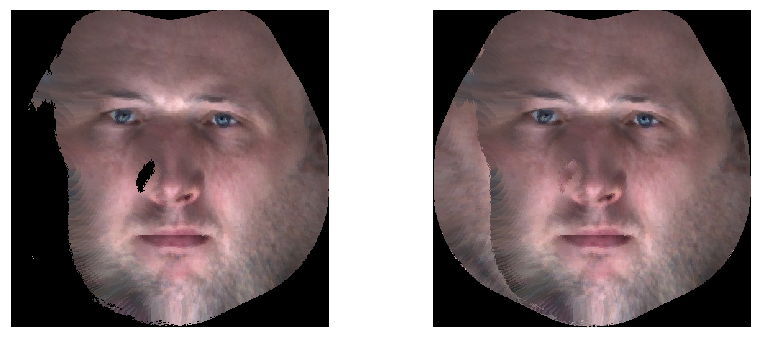

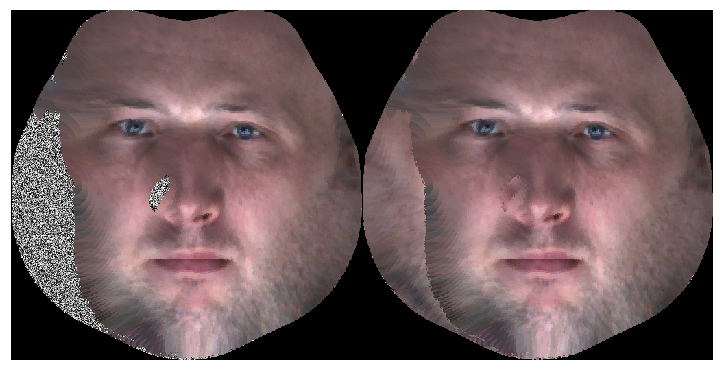

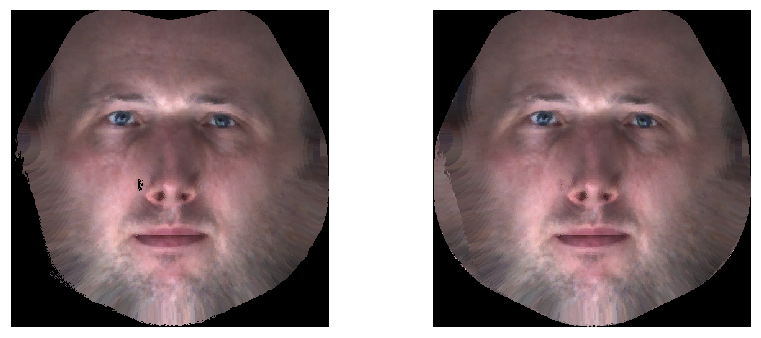

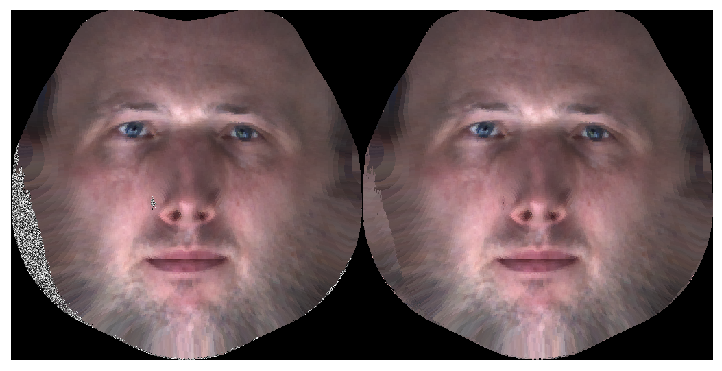

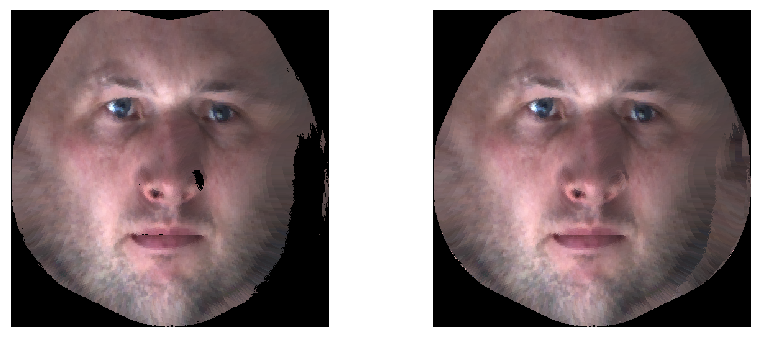

...

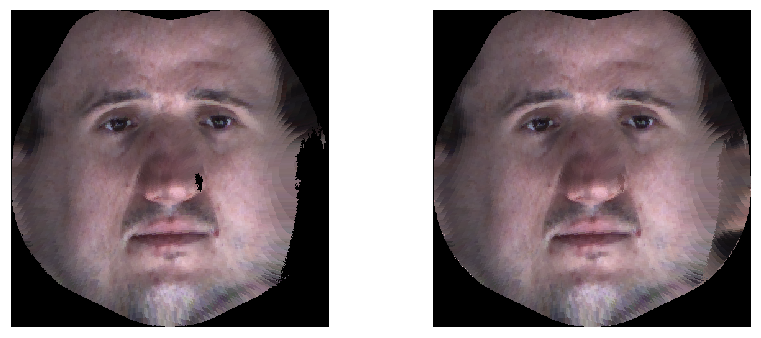

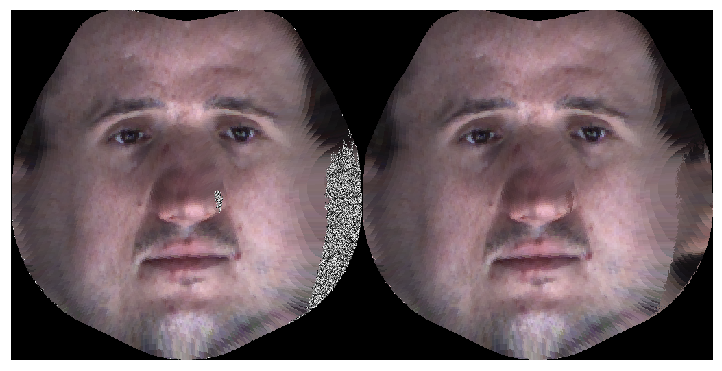

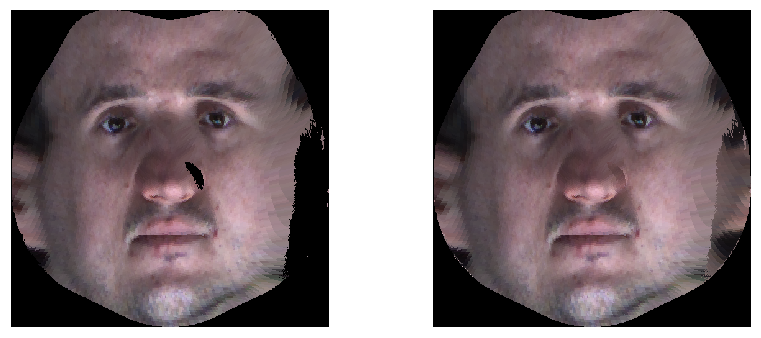

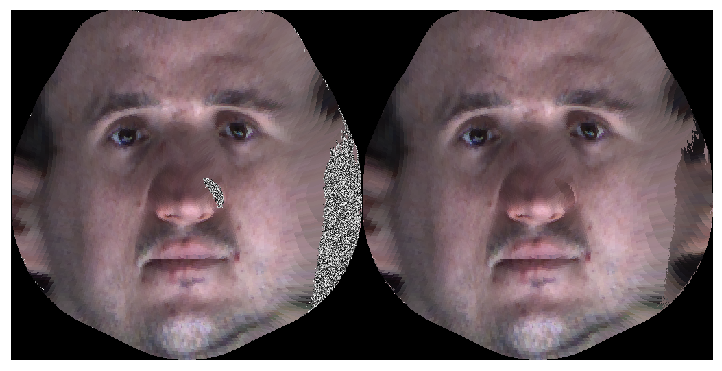

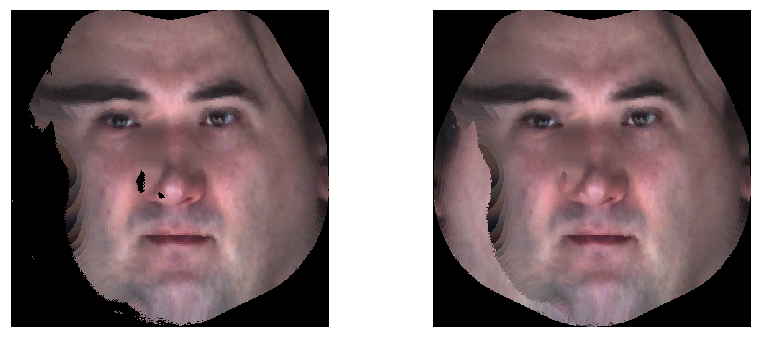

In [ ]:
### 
%matplotlib inline

vis = True
log = False

for idn in id_data.keys():
    
    txt_maps = id_data[idn]
    
    for _, txt in enumerate(txt_maps):
        
        f_name = idn + '_' + str(_) + '.isomap.png'
        if log: print('Processing %s as initializer with name %s' %(txt, f_name))
        
        txt_init = txt 
        txt_list = [i for i in txt_maps if i != txt_init]
        
        im_init = cv2.imread(txt_init, cv2.IMREAD_UNCHANGED)          
        im_last_blend = im_init

        random.seed(1984)
        [random.shuffle(txt_list) for s in range(int(1e2))]
    
        for j in txt_list:

            im = cv2.imread(j, cv2.IMREAD_UNCHANGED)
            im_mask = im[:,:,3] == 0
        
            # create masks
            im_filled = im_last_blend.copy()
            im_filled_mask = im_last_blend[:,:,3] == 0

            # fills the missing areas -info provided by the mask
            im_filled[:,:,:3][im_filled_mask] = im[:,:,:3][im_filled_mask]
            im_filled_mask[im_filled_mask] = im_mask[im_filled_mask]

            im_filled_mask = (np.reshape((~im_filled_mask).astype(np.uint8), im_filled_mask.shape + (1,)) * 255).astype(np.uint8)
            im_filled = np.append(im_filled[:,:,:3], im_filled_mask, axis=2)
            im_last_blend = im_filled 

        # show off
        if vis: plot_ims(np.array([im_init[:,:,:3], im_last_blend[:,:,:3]]), alpha=False)
        
        # save first and last image
        save_intermediate = False
        if save_intermediate:
            o_p_init = '../../datasets/face_database_camera12/output_input_init'
            o_p_label = '../../datasets/face_database_camera12/output_labels'
            if not os.path.exists(o_p_label): os.makedirs(o_p_label)
            if not os.path.exists(o_p_pairs): os.makedirs(o_p_pairs)
            cv2.imwrite(os.path.join(o_p_init, f_name), im_init)
            cv2.imwrite(os.path.join(o_p_label, f_name), im_last_blend)
        
        # preparing pairs
        preprocess = 'W&B' # 'W', 'B'
        im_input, im_label = preprocess_input_and_label(im_init, im_last_blend, fill_input_with = preprocess)
        im_hstack = np.append(im_input, im_label, axis=1)
        
        # show off
        if vis: plot_im(im_hstack, alpha=False) # plot_ims(np.array([im_input, im_label]), alpha=False)
        
        # saving pairs
        save_stack = False
        if save_stack:
            o_p_pairs = '../../datasets/face_database_camera12/output_pairs'
            if not os.path.exists(o_p_init): os.makedirs(o_p_init)
            cv2.imwrite(os.path.join(o_p_pairs, f_name), im_hstack)
        
        # saving separate
        save_separate = False
        if save_separate: 
            o_p_si = os.path.join(o_p_pairs, 'input')
            o_p_sl = os.path.join(o_p_pairs, 'label')
            
            if not os.path.exists(o_p_si): os.makedirs(o_p_si)
            if not os.path.exists(o_p_sl): os.makedirs(o_p_sl)
        
            cv2.imwrite(os.path.join(o_p_si, f_name), im_input)
            cv2.imwrite(os.path.join(o_p_sl, f_name), im_label)
        
        # save occlusions samples
        save_occlusions = True
        if save_occlusions: 
            occ_sample = im_input[:,:,3]
            o_p_occ = '../../datasets/face_database_camera12/output_occlusion_samples' 
            if not os.path.exists(o_p_occ): os.makedirs(o_p_occ)
            cv2.imwrite(os.path.join(o_p_occ, f_name), occ_sample)

In [26]:
txt_pl

['frame_images_DB/Aaron_Eckhart.labeled_faces.txt',
 'frame_images_DB/Aaron_Guiel.labeled_faces.txt',
 'frame_images_DB/Aaron_Patterson.labeled_faces.txt',
 'frame_images_DB/Aaron_Peirsol.labeled_faces.txt',
 'frame_images_DB/Aaron_Sorkin.labeled_faces.txt',
 'frame_images_DB/Aaron_Tippin.labeled_faces.txt',
 'frame_images_DB/Abbas_Kiarostami.labeled_faces.txt',
 'frame_images_DB/Abba_Eban.labeled_faces.txt',
 'frame_images_DB/Abdel_Aziz_Al-Hakim.labeled_faces.txt',
 'frame_images_DB/Abdel_Madi_Shabneh.labeled_faces.txt',
 'frame_images_DB/Abdoulaye_Wade.labeled_faces.txt',
 'frame_images_DB/Abdulaziz_Kamilov.labeled_faces.txt',
 'frame_images_DB/Abdullah.labeled_faces.txt',
 'frame_images_DB/Abdullah_Ahmad_Badawi.labeled_faces.txt',
 'frame_images_DB/Abdullah_al-Attiyah.labeled_faces.txt',
 'frame_images_DB/Abdullah_Gul.labeled_faces.txt',
 'frame_images_DB/Abdullatif_Sener.labeled_faces.txt',
 'frame_images_DB/Abdul_Majeed_Shobokshi.labeled_faces.txt',
 'frame_images_DB/Abdul_Rahman.

In [22]:
from PIL import Image
cm_p = 'resources/masks/contour_mask.png'
img = Image.open(cm_p)
arr = array(img)

In [26]:
import PIL
print(PIL.__version__)

import tarfile
path = '/blanca/test_youtube_video/frame_images_DB.tar.gz'
file = tarfile.open(name=path, mode='r', fileobj=None, bufsize=10240)
file_names = file.getnames()

4.2.1


#### MAIN Youtube

In [76]:
import tarfile
path = '/blanca/test_youtube_video/frame_images_DB.tar.gz'
file = tarfile.open(name=path, mode='r', fileobj=None, bufsize=10240)
file_names = file.getnames()

txt_pl = [i for i in file_names if '.txt' in i]

# i_p = '/blanca/test_youtube_video/frame_images_DB'
print('Total diferent ids:', len(txt_pl))

thwidth = 150

max_l = []
for txt_p in txt_pl:
    print('Processing file..', txt_p)
    txt_f = file.extractfile(txt_p).read().splitlines()
#     txt = open(txt_f,'r').read().splitlines()
    for i in txt_f:
        filename,_,x,y,width,height,_,_= i.decode('utf-8').split(',')
        if int(width) > thwidth:
            max_l.append([filename.replace('\\', '/'),int(width),int(height)])

uid_pl = []
for i in max_l:
    fi_p = i[0]
    fo_p = os.path.join(fi_p.split('/')[0], fi_p.split('/')[1])
    if fo_p not in uid_pl: uid_pl.append(fo_p)

print('Total number of unique ids: %d   |   Total number of selected unique ids (face width > %d pixels): %d' %(len(txt_pl), thwidth, len(uid_pl)), end='')

print('..corresponding to a a total of %d images' %print(len(max_l)))

Total diferent ids: 3083
Processing file.. frame_images_DB/Aaron_Eckhart.labeled_faces.txt
Processing file.. frame_images_DB/Aaron_Guiel.labeled_faces.txt
Processing file.. frame_images_DB/Aaron_Patterson.labeled_faces.txt
Processing file.. frame_images_DB/Aaron_Peirsol.labeled_faces.txt
Processing file.. frame_images_DB/Aaron_Sorkin.labeled_faces.txt
Processing file.. frame_images_DB/Aaron_Tippin.labeled_faces.txt
Processing file.. frame_images_DB/Abbas_Kiarostami.labeled_faces.txt
Processing file.. frame_images_DB/Abba_Eban.labeled_faces.txt
Processing file.. frame_images_DB/Abdel_Aziz_Al-Hakim.labeled_faces.txt
Processing file.. frame_images_DB/Abdel_Madi_Shabneh.labeled_faces.txt
Processing file.. frame_images_DB/Abdoulaye_Wade.labeled_faces.txt
Processing file.. frame_images_DB/Abdulaziz_Kamilov.labeled_faces.txt
Processing file.. frame_images_DB/Abdullah.labeled_faces.txt
Processing file.. frame_images_DB/Abdullah_Ahmad_Badawi.labeled_faces.txt
Processing file.. frame_images_DB/A

Processing file.. frame_images_DB/Alexandre_Despatie.labeled_faces.txt
Processing file.. frame_images_DB/Alexandre_Herchcovitch.labeled_faces.txt
Processing file.. frame_images_DB/Alexandre_Vinokourov.labeled_faces.txt
Processing file.. frame_images_DB/Alexa_Loren.labeled_faces.txt
Processing file.. frame_images_DB/Alexa_Vega.labeled_faces.txt
Processing file.. frame_images_DB/Alexis_Bledel.labeled_faces.txt
Processing file.. frame_images_DB/Alexis_Dennisoff.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Barros.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Cabrera.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Cejka.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Corretja.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Ferguson.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Gonzalez.labeled_faces.txt
Processing file.. frame_images_DB/Alex_Holmes.labeled_faces.txt
Processing file.. frame_images_DB/Alex_King.labeled_faces.txt
Pro

Processing file.. frame_images_DB/Andy_Garcia.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Griffith.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Griggs.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Hebb.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Lau.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Madikians.labeled_faces.txt
Processing file.. frame_images_DB/Andy_North.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Roddick.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Rooney.labeled_faces.txt
Processing file.. frame_images_DB/Andy_Warhol.labeled_faces.txt
Processing file.. frame_images_DB/Anette_Hosoi.labeled_faces.txt
Processing file.. frame_images_DB/Angela_Alvarado_Rosa.labeled_faces.txt
Processing file.. frame_images_DB/Angela_Bassett.labeled_faces.txt
Processing file.. frame_images_DB/Angela_Lansbury.labeled_faces.txt
Processing file.. frame_images_DB/Angela_Mascia-Frye.labeled_faces.txt
Processing file.

Processing file.. frame_images_DB/Bill_Duffey.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Elliott.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Fennelly.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Frist.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Gates.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Graham.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Guerin.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Herrion.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Hughes.labeled_faces.txt
Processing file.. frame_images_DB/Bill_King.labeled_faces.txt
Processing file.. frame_images_DB/Bill_Kollar.labeled_faces.txt
Processing file.. frame_images_DB/BJ_Habibie.labeled_faces.txt
Processing file.. frame_images_DB/Brendan_Fraser.labeled_faces.txt
Processing file.. frame_images_DB/Brendan_Gaughan.labeled_faces.txt
Processing file.. frame_images_DB/Brendan_Stai.labeled_faces.txt
Processing file.. frame_images_DB

Processing file.. frame_images_DB/Celso_Lafer.labeled_faces.txt
Processing file.. frame_images_DB/Cemil_Cicek.labeled_faces.txt
Processing file.. frame_images_DB/Cesar_Gaviria.labeled_faces.txt
Processing file.. frame_images_DB/Cesar_Maia.labeled_faces.txt
Processing file.. frame_images_DB/Chadha_Gurinder.labeled_faces.txt
Processing file.. frame_images_DB/Chakib_Khelil.labeled_faces.txt
Processing file.. frame_images_DB/Chanda_Rubin.labeled_faces.txt
Processing file.. frame_images_DB/Chandrika_Kumaratunga.labeled_faces.txt
Processing file.. frame_images_DB/Chan_Choi.labeled_faces.txt
Processing file.. frame_images_DB/Chan_Gailey.labeled_faces.txt
Processing file.. frame_images_DB/Charla_Moye.labeled_faces.txt
Processing file.. frame_images_DB/Charles_Bronson.labeled_faces.txt
Processing file.. frame_images_DB/Charles_Chandler_IV.labeled_faces.txt
Processing file.. frame_images_DB/Charles_Cope.labeled_faces.txt
Processing file.. frame_images_DB/Charles_Grassley.labeled_faces.txt
Proces

Processing file.. frame_images_DB/Chris_Thomas.labeled_faces.txt
Processing file.. frame_images_DB/Chris_Tucker.labeled_faces.txt
Processing file.. frame_images_DB/Chris_Whitney.labeled_faces.txt
Processing file.. frame_images_DB/Chuanyun_Li.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Amato.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Bednarik.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Eidson.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Hagel.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Woolery.labeled_faces.txt
Processing file.. frame_images_DB/Chuck_Yeager.labeled_faces.txt
Processing file.. frame_images_DB/Chung_Mong-hun.labeled_faces.txt
Processing file.. frame_images_DB/Chung_Mong-joon.labeled_faces.txt
Processing file.. frame_images_DB/Ciaran_Hinds.labeled_faces.txt
Processing file.. frame_images_DB/Cindy_Crawford.labeled_faces.txt
Processing file.. frame_images_DB/Cindy_Klassen.labeled_faces.txt
Processing file.

Processing file.. frame_images_DB/Daniel_Montenegro.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Montgomery.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Ortega.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Osorno.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Patrick_Moynihan.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Pearl.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Radcliffe.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Rouse.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Scioli.labeled_faces.txt
Processing file.. frame_images_DB/Daniel_Zelman.labeled_faces.txt
Processing file.. frame_images_DB/Danis_Tanovic.labeled_faces.txt
Processing file.. frame_images_DB/Danny_Ainge.labeled_faces.txt
Processing file.. frame_images_DB/Danny_Avalon.labeled_faces.txt
Processing file.. frame_images_DB/Danny_Elfman.labeled_faces.txt
Processing file.. frame_images_DB/Danny_Glover.labeled_faces.

Processing file.. frame_images_DB/Elena_de_Chavez.labeled_faces.txt
Processing file.. frame_images_DB/Elena_Likhovtseva.labeled_faces.txt
Processing file.. frame_images_DB/Elena_Tihomirova.labeled_faces.txt
Processing file.. frame_images_DB/Elgin_Baylor.labeled_faces.txt
Processing file.. frame_images_DB/Eliane_Karp.labeled_faces.txt
Processing file.. frame_images_DB/Elias_Attallah.labeled_faces.txt
Processing file.. frame_images_DB/Elijah_Wood.labeled_faces.txt
Processing file.. frame_images_DB/Elijan_Ingram.labeled_faces.txt
Processing file.. frame_images_DB/Elinor_Caplan.labeled_faces.txt
Processing file.. frame_images_DB/Elin_Nordegren.labeled_faces.txt
Processing file.. frame_images_DB/Eliott_Spitzer.labeled_faces.txt
Processing file.. frame_images_DB/Elisabeth_Schumacher.labeled_faces.txt
Processing file.. frame_images_DB/Elisabeth_Welch.labeled_faces.txt
Processing file.. frame_images_DB/Elisha_Cuthbert.labeled_faces.txt
Processing file.. frame_images_DB/Elizabeth_Berkeley.label

Processing file.. frame_images_DB/Eva_Marie_Saint.labeled_faces.txt
Processing file.. frame_images_DB/Eva_Mendes.labeled_faces.txt
Processing file.. frame_images_DB/Eve_Ensler.labeled_faces.txt
Processing file.. frame_images_DB/Evo_Morales.labeled_faces.txt
Processing file.. frame_images_DB/Ewan_McGregor.labeled_faces.txt
Processing file.. frame_images_DB/E_Clay_Shaw.labeled_faces.txt
Processing file.. frame_images_DB/Faisal_Saleh_Hayat.labeled_faces.txt
Processing file.. frame_images_DB/Farida_Ragoonanan.labeled_faces.txt
Processing file.. frame_images_DB/Farouk_Kaddoumi.labeled_faces.txt
Processing file.. frame_images_DB/Fatmir_Limaj.labeled_faces.txt
Processing file.. frame_images_DB/Fazal-ur-Rehman.labeled_faces.txt
Processing file.. frame_images_DB/Federico_Castelan_Sayre.labeled_faces.txt
Processing file.. frame_images_DB/Federico_Fellini.labeled_faces.txt
Processing file.. frame_images_DB/Federico_Trillo.labeled_faces.txt
Processing file.. frame_images_DB/Felicity_Huffman.labele

Processing file.. frame_images_DB/Garry_McCoy.labeled_faces.txt
Processing file.. frame_images_DB/Garry_Trudeau.labeled_faces.txt
Processing file.. frame_images_DB/Garry_Witherall.labeled_faces.txt
Processing file.. frame_images_DB/Garth_Drabinsky.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Bald.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Barnett.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Bauer.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Bergeron.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Bettman.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Carter.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Coleman.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Condit.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Dellaverson.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Forsee.labeled_faces.txt
Processing file.. frame_images_DB/Gary_Gero.labeled_faces.txt
Processing file.. frame_i

Processing file.. frame_images_DB/Hartmut_Mehdorn.labeled_faces.txt
Processing file.. frame_images_DB/Harvey_Fierstein.labeled_faces.txt
Processing file.. frame_images_DB/Harvey_Weinstein.labeled_faces.txt
Processing file.. frame_images_DB/Hasan_Wirayuda.labeled_faces.txt
Processing file.. frame_images_DB/Hashim_Thaci.labeled_faces.txt
Processing file.. frame_images_DB/Hassan_Nasrallah.labeled_faces.txt
Processing file.. frame_images_DB/Hassan_Wirajuda.labeled_faces.txt
Processing file.. frame_images_DB/Iain_Duncan_Smith.labeled_faces.txt
Processing file.. frame_images_DB/Iain_Richmond.labeled_faces.txt
Processing file.. frame_images_DB/Ian_Campbell.labeled_faces.txt
Processing file.. frame_images_DB/Ian_Gillan.labeled_faces.txt
Processing file.. frame_images_DB/Ian_Huntley.labeled_faces.txt
Processing file.. frame_images_DB/Ian_Knop.labeled_faces.txt
Processing file.. frame_images_DB/Ian_McKellen.labeled_faces.txt
Processing file.. frame_images_DB/Ian_Smith.labeled_faces.txt
Processin

Processing file.. frame_images_DB/James_Cunningham.labeled_faces.txt
Processing file.. frame_images_DB/James_Dingemans.labeled_faces.txt
Processing file.. frame_images_DB/James_Franco.labeled_faces.txt
Processing file.. frame_images_DB/James_Gandolfini.labeled_faces.txt
Processing file.. frame_images_DB/James_Hakett.labeled_faces.txt
Processing file.. frame_images_DB/James_Hallock.labeled_faces.txt
Processing file.. frame_images_DB/James_Harris.labeled_faces.txt
Processing file.. frame_images_DB/James_Hill.labeled_faces.txt
Processing file.. frame_images_DB/James_Hoffa.labeled_faces.txt
Processing file.. frame_images_DB/James_Hughes.labeled_faces.txt
Processing file.. frame_images_DB/James_Ivory.labeled_faces.txt
Processing file.. frame_images_DB/James_Jones.labeled_faces.txt
Processing file.. frame_images_DB/James_Kelly.labeled_faces.txt
Processing file.. frame_images_DB/James_Kirtley.labeled_faces.txt
Processing file.. frame_images_DB/James_Kopp.labeled_faces.txt
Processing file.. fr

Processing file.. frame_images_DB/Keith_Bogans.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Fotta.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Lockhart.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Olbermann.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Rodriguez.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Tyson.labeled_faces.txt
Processing file.. frame_images_DB/Keith_Van_Horn.labeled_faces.txt
Processing file.. frame_images_DB/Kellie_Greene.labeled_faces.txt
Processing file.. frame_images_DB/Kelly_Leigh.labeled_faces.txt
Processing file.. frame_images_DB/Kelly_Ripa.labeled_faces.txt
Processing file.. frame_images_DB/Kelsey_Grammer.labeled_faces.txt
Processing file.. frame_images_DB/Kemal_Dervis.labeled_faces.txt
Processing file.. frame_images_DB/Kenenisa_Bekele.labeled_faces.txt
Processing file.. frame_images_DB/Kenneth_Branagh.labeled_faces.txt
Processing file.. frame_images_DB/Kenneth_Carlsen.labeled_faces.txt
Processi

Processing file.. frame_images_DB/Lauren_Killian.labeled_faces.txt
Processing file.. frame_images_DB/Laurie_Chan.labeled_faces.txt
Processing file.. frame_images_DB/Laurie_Hobbs.labeled_faces.txt
Processing file.. frame_images_DB/Laurie_Laychak.labeled_faces.txt
Processing file.. frame_images_DB/Laurie_Pirtle.labeled_faces.txt
Processing file.. frame_images_DB/Lawrence_Di_Rita.labeled_faces.txt
Processing file.. frame_images_DB/Lawrence_MacAulay.labeled_faces.txt
Processing file.. frame_images_DB/Lawrence_Roberts.labeled_faces.txt
Processing file.. frame_images_DB/Lawrence_Vito.labeled_faces.txt
Processing file.. frame_images_DB/Lazaro_Castro.labeled_faces.txt
Processing file.. frame_images_DB/Leah_Remini.labeled_faces.txt
Processing file.. frame_images_DB/Leandrinho_Barbosa.labeled_faces.txt
Processing file.. frame_images_DB/Leandro_Andrade.labeled_faces.txt
Processing file.. frame_images_DB/Leandro_Garcia.labeled_faces.txt
Processing file.. frame_images_DB/LeAnn_Rimes.labeled_faces.t

Processing file.. frame_images_DB/Lori_Berenson.labeled_faces.txt
Processing file.. frame_images_DB/Lorne_Michaels.labeled_faces.txt
Processing file.. frame_images_DB/Lorraine_Bracco.labeled_faces.txt
Processing file.. frame_images_DB/Lorraine_Fenton.labeled_faces.txt
Processing file.. frame_images_DB/Louisa_Baileche.labeled_faces.txt
Processing file.. frame_images_DB/Louis_Van_Gaal.labeled_faces.txt
Processing file.. frame_images_DB/Lou_Lang.labeled_faces.txt
Processing file.. frame_images_DB/Lou_Reed.labeled_faces.txt
Processing file.. frame_images_DB/Lou_Ye.labeled_faces.txt
Processing file.. frame_images_DB/Lubomir_Zaoralek.labeled_faces.txt
Processing file.. frame_images_DB/Luca_Cordero_di_Montezemolo.labeled_faces.txt
Processing file.. frame_images_DB/Luciano_Bovicelli.labeled_faces.txt
Processing file.. frame_images_DB/Luciano_Pavarotti.labeled_faces.txt
Processing file.. frame_images_DB/Lucia_Kenny_Anthony.labeled_faces.txt
Processing file.. frame_images_DB/Lucie_Lapovsky.label

Processing file.. frame_images_DB/Marianne_Stanley.labeled_faces.txt
Processing file.. frame_images_DB/Mariano_Zabaleta.labeled_faces.txt
Processing file.. frame_images_DB/Marian_Dolan.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Bello.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Burks.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Callas.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Conchita_Alonso.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Garcia.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Guida.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Luisa_Mendonca.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Sanchez_Lorenzo.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Shkolnikova.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Shriver.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Simon.labeled_faces.txt
Processing file.. frame_images_DB/Maria_Soledad_Alvear

Processing file.. frame_images_DB/Nancy_Powell.labeled_faces.txt
Processing file.. frame_images_DB/Nancy_Reagan.labeled_faces.txt
Processing file.. frame_images_DB/Nancy_Sinatra.labeled_faces.txt
Processing file.. frame_images_DB/Nancy_Smith.labeled_faces.txt
Processing file.. frame_images_DB/Nanni_Moretti.labeled_faces.txt
Processing file.. frame_images_DB/Nan_Wang.labeled_faces.txt
Processing file.. frame_images_DB/Naomi_Bronstein.labeled_faces.txt
Processing file.. frame_images_DB/Naomi_Campbell.labeled_faces.txt
Processing file.. frame_images_DB/Naomi_Hayashi.labeled_faces.txt
Processing file.. frame_images_DB/Naomi_Watts.labeled_faces.txt
Processing file.. frame_images_DB/Naoto_Kan.labeled_faces.txt
Processing file.. frame_images_DB/Narayan_Singh_Pun.labeled_faces.txt
Processing file.. frame_images_DB/Narendra_Modi.labeled_faces.txt
Processing file.. frame_images_DB/Nasser_al-Kidwa.labeled_faces.txt
Processing file.. frame_images_DB/Nastassia_Kinski.labeled_faces.txt
Processing fi

Processing file.. frame_images_DB/Odilia_Collazo.labeled_faces.txt
Processing file.. frame_images_DB/OJ_Simpson.labeled_faces.txt
Processing file.. frame_images_DB/Oleg_Romantsev.labeled_faces.txt
Processing file.. frame_images_DB/Oleksandr_Moroz.labeled_faces.txt
Processing file.. frame_images_DB/Olene_Walker.labeled_faces.txt
Processing file.. frame_images_DB/Olesya_Bonabarenko.labeled_faces.txt
Processing file.. frame_images_DB/Oliver_Neuville.labeled_faces.txt
Processing file.. frame_images_DB/Oliver_Phelps.labeled_faces.txt
Processing file.. frame_images_DB/Oliver_Stone.labeled_faces.txt
Processing file.. frame_images_DB/Olivia_Newton-John.labeled_faces.txt
Processing file.. frame_images_DB/Olivier_Boulay.labeled_faces.txt
Processing file.. frame_images_DB/Olivier_Rochus.labeled_faces.txt
Processing file.. frame_images_DB/Olympia_Dukakis.labeled_faces.txt
Processing file.. frame_images_DB/Omar_Khan_Sharif.labeled_faces.txt
Processing file.. frame_images_DB/Omar_Sharif.labeled_face

Processing file.. frame_images_DB/Paul_Hogan.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Johnson.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Kagame.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Kariya.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Kelleher.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Krueger.labeled_faces.txt
Processing file.. frame_images_DB/Paul_LeClerc.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Li_Calsi.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Lockhart.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Lo_Duca.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Luvera.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Martin.labeled_faces.txt
Processing file.. frame_images_DB/Paul_McNulty.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Michael_Daniels.labeled_faces.txt
Processing file.. frame_images_DB/Paul_Murphy.labeled_faces.txt
Processing file.. fra

Processing file.. frame_images_DB/Pieter_Bouw.labeled_faces.txt
Processing file.. frame_images_DB/Pilar_Montenegro.labeled_faces.txt
Processing file.. frame_images_DB/Pinar_del_Rio.labeled_faces.txt
Processing file.. frame_images_DB/Piotr_Anderszewski.labeled_faces.txt
Processing file.. frame_images_DB/Pio_Laghi.labeled_faces.txt
Processing file.. frame_images_DB/Placido_Domingo.labeled_faces.txt
Processing file.. frame_images_DB/Platon_Lebedev.labeled_faces.txt
Processing file.. frame_images_DB/Poala_Suarez.labeled_faces.txt
Processing file.. frame_images_DB/Polona_Bas.labeled_faces.txt
Processing file.. frame_images_DB/Porter_Goss.labeled_faces.txt
Processing file.. frame_images_DB/Portia_de_Rossi.labeled_faces.txt
Processing file.. frame_images_DB/Prakash_Hinduja.labeled_faces.txt
Processing file.. frame_images_DB/Prem_Kumar_Nair.labeled_faces.txt
Processing file.. frame_images_DB/Princess_Aiko.labeled_faces.txt
Processing file.. frame_images_DB/Princess_Anne.labeled_faces.txt
Proce

Processing file.. frame_images_DB/Richard_Tubb.labeled_faces.txt
Processing file.. frame_images_DB/Richard_Ward.labeled_faces.txt
Processing file.. frame_images_DB/Rich_Brooks.labeled_faces.txt
Processing file.. frame_images_DB/Ricky_Barnes.labeled_faces.txt
Processing file.. frame_images_DB/Ricky_Martin.labeled_faces.txt
Processing file.. frame_images_DB/Ricky_Quick.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Barnes.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Bragg.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Caruso.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Husband.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Perry.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Reed.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Romley.labeled_faces.txt
Processing file.. frame_images_DB/Rick_Stansbury.labeled_faces.txt
Processing file.. frame_images_DB/Ridley_Scott.labeled_faces.txt
Processing file.. frame_images_DB/R

Processing file.. frame_images_DB/Sarah_Hughes.labeled_faces.txt
Processing file.. frame_images_DB/Sarah_Jessica_Parker.labeled_faces.txt
Processing file.. frame_images_DB/Sarah_Michelle_Gellar.labeled_faces.txt
Processing file.. frame_images_DB/Sarah_Price.labeled_faces.txt
Processing file.. frame_images_DB/Sarah_Weddington.labeled_faces.txt
Processing file.. frame_images_DB/Sarah_Wynter.labeled_faces.txt
Processing file.. frame_images_DB/Sara_Elisabeth_Ahmad.labeled_faces.txt
Processing file.. frame_images_DB/Sara_Silverman.labeled_faces.txt
Processing file.. frame_images_DB/Sargis_Sargsian.labeled_faces.txt
Processing file.. frame_images_DB/Sasha_Alexander.labeled_faces.txt
Processing file.. frame_images_DB/Sasha_Cohen.labeled_faces.txt
Processing file.. frame_images_DB/Scott_Blum.labeled_faces.txt
Processing file.. frame_images_DB/Scott_Dalton.labeled_faces.txt
Processing file.. frame_images_DB/Scott_Dickson.labeled_faces.txt
Processing file.. frame_images_DB/SJ_Twu.labeled_faces.t

Processing file.. frame_images_DB/Timothy_McVeigh.labeled_faces.txt
Processing file.. frame_images_DB/Timothy_Rigas.labeled_faces.txt
Processing file.. frame_images_DB/Timothy_Wirth.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Allen.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Blake_Nelson.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Chapman.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Conway.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Curley.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Curry.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Duncan.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Henman.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Howard.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Jones.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Lobinger.labeled_faces.txt
Processing file.. frame_images_DB/Tim_Lopes.labeled_faces.txt
Processing file.. frame_images_DB/Tim_M

Processing file.. frame_images_DB/Vivica_Fox.labeled_faces.txt
Processing file.. frame_images_DB/Vladimiro_Montesinos.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Golovlyov.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Meciar.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Putin.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Spidla.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Ustinov.labeled_faces.txt
Processing file.. frame_images_DB/Vladimir_Voltchkov.labeled_faces.txt
Processing file.. frame_images_DB/Vojislav_Kostunica.labeled_faces.txt
Processing file.. frame_images_DB/Vojislav_Seselj.labeled_faces.txt
Processing file.. frame_images_DB/Vyacheslav_Fetisov.labeled_faces.txt
Processing file.. frame_images_DB/Vytas_Danelius.labeled_faces.txt
Processing file.. frame_images_DB/Walid_Al-Awadi.labeled_faces.txt
Processing file.. frame_images_DB/Wallace_Capel.labeled_faces.txt
Processing file.. frame_images_DB/Wally_

Processing file.. frame_images_DB/Yuri_Fedotov.labeled_faces.txt
Processing file.. frame_images_DB/Yuri_Luzhkov.labeled_faces.txt
Processing file.. frame_images_DB/Yuri_Malenchenko.labeled_faces.txt
Processing file.. frame_images_DB/Yusaku_Miyazato.labeled_faces.txt
Processing file.. frame_images_DB/Yuvraj_Singh.labeled_faces.txt
Processing file.. frame_images_DB/Yu_Shyi-kun.labeled_faces.txt
Processing file.. frame_images_DB/Zach_Pillar.labeled_faces.txt
Processing file.. frame_images_DB/Zach_Safrin.labeled_faces.txt
Processing file.. frame_images_DB/Zafarullah_Khan_Jamali.labeled_faces.txt
Processing file.. frame_images_DB/Zahir_Shah.labeled_faces.txt
Processing file.. frame_images_DB/Zaini_Abdullah.labeled_faces.txt
Processing file.. frame_images_DB/Zakia_Hakki.labeled_faces.txt
Processing file.. frame_images_DB/Zalmay_Khalilzad.labeled_faces.txt
Processing file.. frame_images_DB/Zarai_Toledo.labeled_faces.txt
Processing file.. frame_images_DB/Zavad_Zarif.labeled_faces.txt
Processin

In [ ]:
## extracting
i_p = '/blanca/test_youtube_video'
# if not os.path.exists(o_p): os.makedirs(o_p)
for i in max_l:
    file.extract(os.path.join('frame_images_DB', i[0]), path=i_p)
#     id_o_p = os.path.join(o_p, os.path.join(i[0].split('/')[0], i[0].split('/')[1])); print(id_o_p)
#     if not os.path.exists(id_o_p): os.makedirs(id_o_p)
#     os.system('cp %s %s' %(os.path.join(i_p, i[0]), os.path.join(id_o_p, i[0])))

In [104]:
# !python ../../project/3d-model-fitting-pipeline/src/main.py -i p -ss

In [116]:
gi_p = ids_p
f_pl = [i for i in os.listdir(gi_p) if os.path.isdir(os.path.join(gi_p, i))]
# f_pl = [os.path.join(i, j) for i in f_pl for j in os.listdir(os.path.join(gi_p, i))] 
f_pl

['Aaron_Tippin',
 'Abbas_Kiarostami',
 'Abba_Eban',
 'Abdel_Aziz_Al-Hakim',
 'Abdulaziz_Kamilov',
 'Abdullah',
 'Abel_Pacheco']

In [46]:
EXT_RECURSIVE = ['**/*.jpg', '**/*.JPG', '**/*.png', '**/*.ppm']
from collections import OrderedDict

# global path
dataset = Path('../../test_youtube_video')
ids_p = dataset/'output_fitting_pipeline'

id_names = [i.parts[-1] for i in list(ids_p.glob('*')) if os.path.isdir(i)]

id_data = OrderedDict({i: {} for i in sorted(id_names)})

for i in id_names:
    for j in os.listdir(ids_p/i):
        id_data[i][j] = None

for i in id_data.keys():
    for j in id_data[i].keys():
#         type(ids_p/i/j)
        txt_pl = reduce(
              operator.add,
              [list((ids_p/i/j).glob('**/*.isomap.png'))],
              [])
        
        id_data[i][j] = txt_pl

id_data

OrderedDict([('Aaron_Tippin',
              {'1': [PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1595.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1647.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1650.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1654.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1655.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1656.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1657.isomap.png'),
                PosixPath('../../test_youtube_video/output_fitting_pipeline/Aaron_Tippin/1/fitting/1.1658.isomap.png'),
     

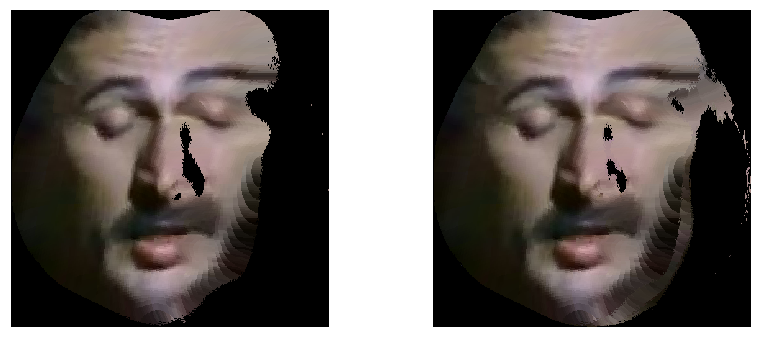

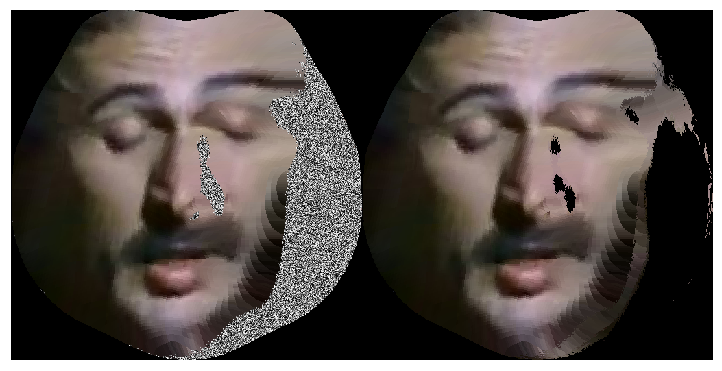

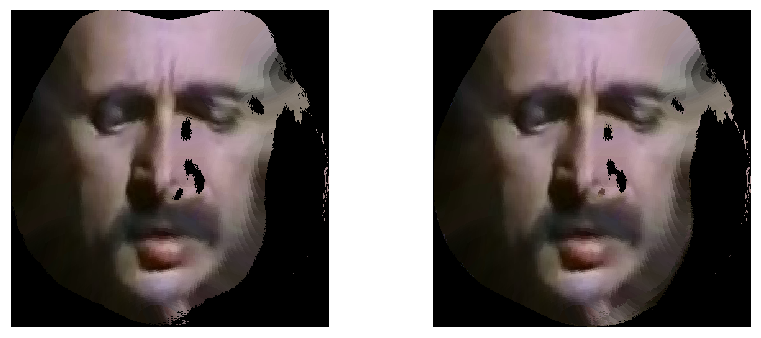

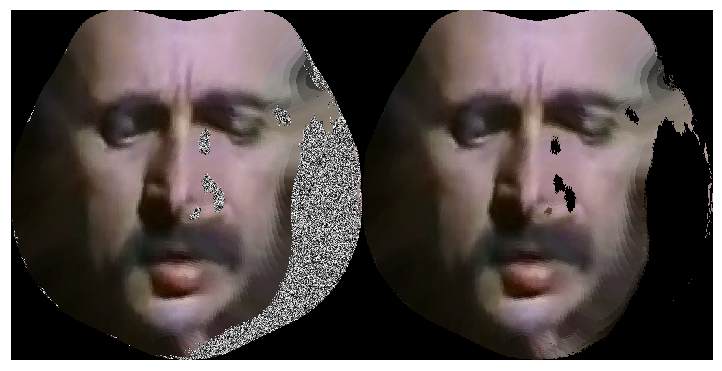

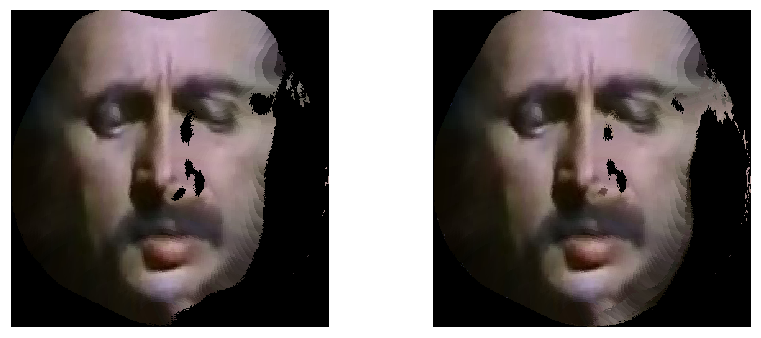

...

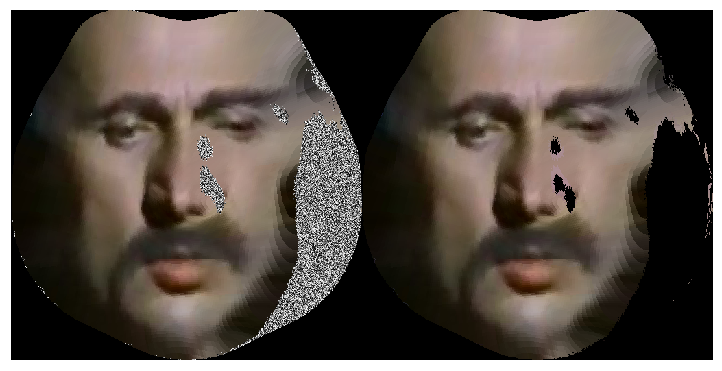

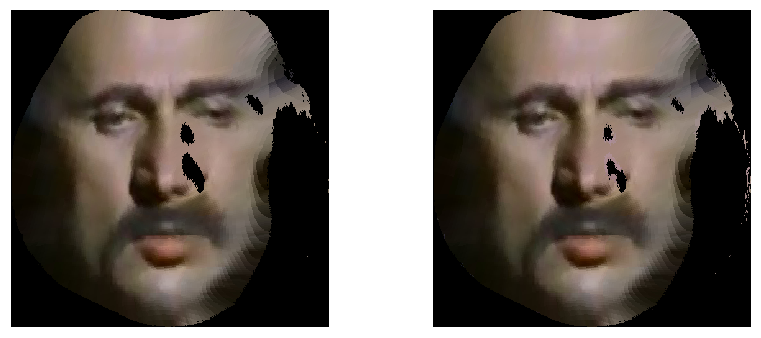

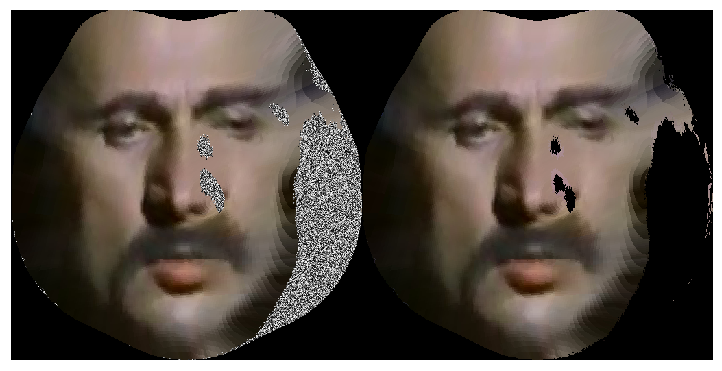

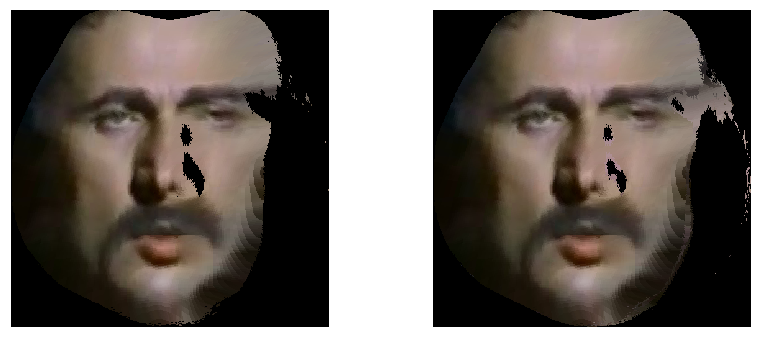

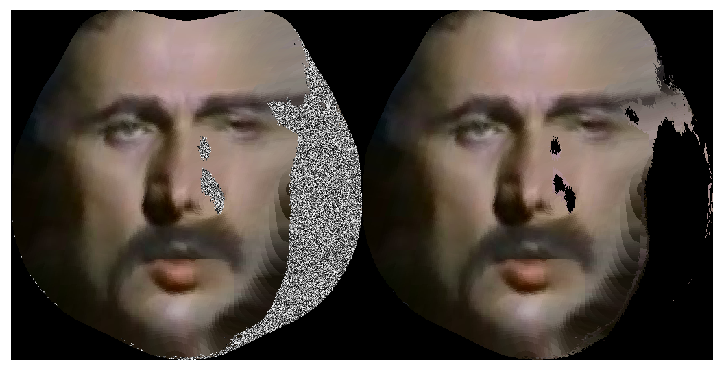

In [ ]:
### 
from pathlib import Path
%matplotlib inline

o_p = dataset

vis = True
log = False

for ID in id_data.keys():
    
    for idn in id_data[ID].keys():
        
        txt_maps = id_data[ID][idn]
        
        for _, txt in enumerate(txt_maps):

            # ID + '_' + idn + '_' +
            f_name =  str(_) + '.isomap.png'
            if log: print('Processing %s as initializer with name %s' %(txt, f_name))

            txt_init = txt 
            txt_list = [i for i in list(txt_maps) if i != txt_init]

            im_init = cv2.imread(str(txt_init), cv2.IMREAD_UNCHANGED)          
            im_last_blend = im_init

            random.seed(1984)
            [random.shuffle(txt_list) for s in range(int(1e2))]

            for j in txt_list:

                im = cv2.imread(str(j), cv2.IMREAD_UNCHANGED)
                im_mask = im[:,:,3] == 0

                # create masks
                im_filled = im_last_blend.copy()
                im_filled_mask = im_last_blend[:,:,3] == 0

                # fills the missing areas -info provided by the mask
                im_filled[:,:,:3][im_filled_mask] = im[:,:,:3][im_filled_mask]
                im_filled_mask[im_filled_mask] = im_mask[im_filled_mask]

                im_filled_mask = (np.reshape((~im_filled_mask).astype(np.uint8), im_filled_mask.shape + (1,)) * 255).astype(np.uint8)
                im_filled = np.append(im_filled[:,:,:3], im_filled_mask, axis=2)
                im_last_blend = im_filled 

            # show off
            if vis: plot_ims(np.array([im_init[:,:,:3], im_last_blend[:,:,:3]]), alpha=False)

            # save first and last image
            save_intermediate = False
            if save_intermediate:
                o_p_init = o_p/'output_input_init'/ID/idn
                o_p_label = o_p/'output_labels'/ID/idn
                if not os.path.exists(o_p_label): os.makedirs(o_p_label)
                if not os.path.exists(o_p_pairs): os.makedirs(o_p_pairs)
                cv2.imwrite(str(o_p_init/f_name), im_init)
                cv2.imwrite(str(o_p_label/f_name), im_last_blend)

            # preparing pairs
            preprocess = 'W&B' # 'W', 'B'
            im_input, im_label = preprocess_input_and_label(im_init, im_last_blend, fill_input_with = preprocess)
            im_hstack = np.append(im_input, im_label, axis=1)

            # show off
            if vis: plot_im(im_hstack, alpha=False) # plot_ims(np.array([im_input, im_label]), alpha=False)

            # saving pairs
            save_stack = True
            if save_stack:
                o_p_pairs = o_p/'output_pairs'/ID/idn
                if not os.path.exists(o_p_pairs): os.makedirs(o_p_pairs)
                cv2.imwrite(str(o_p_pairs/f_name), im_hstack)

            # saving separate
            save_separate = False
            if save_separate: 
                o_p_si = o_p_pairs/'input'
                o_p_sl = o_p_pairs/'label'

                if not os.path.exists(o_p_si): os.makedirs(o_p_si)
                if not os.path.exists(o_p_sl): os.makedirs(o_p_sl)

                cv2.imwrite(str(o_p_si/f_name), im_input)
                cv2.imwrite(str(o_p_sl/f_name), im_label)

            # save occlusions samples
            save_occlusions = False
            if save_occlusions: 
                occ_sample = im_input[:,:,3]
                o_p_occ = o_p/'output_occlusion_samples'
                if not os.path.exists(o_p_occ): os.makedirs(o_p_occ)
                cv2.imwrite(str(o_p_occ/f_name), occ_sample)